### TreeWAS: where GWAS and phylogenies meet
In this exercise we will learn how to use TreeWAS (https://doi.org/10.1101/140798). TreeWAS is an R package that implements a new phylogenetic method to perform genome-wide association studies in microbes. The novelty of this method is that it accounts for population structure.

In [2]:
# We install and load devtools. We need this package to install other R packages from github
install.packages("devtools", dep=TRUE,repos="https://cran.r-project.org")
library(devtools)
if (file.exists(Sys.getenv("TAR")) == FALSE)  {
    Sys.setenv(TAR = "/bin/tar")
}
# We install treeWAS from github
install_github("caitiecollins/treeWAS/pkg", build_vignettes = TRUE)

SyntaxError: invalid syntax (<ipython-input-2-c821c90baa6b>, line 4)

In [3]:
# We load treeWAS
library(treeWAS)
# In order to have a look at the original code for this example, please run the following code on RStudio or a terminal window
#browseVignettes("treeWAS")

NameError: name 'library' is not defined

In [32]:
# We load the data of the example that comes with treeWAS
data(snps)
data(phen)
data(tree)
data(phen.plot.col)

In [33]:
# We have a look at the variables 
str(snps)

 num [1:100, 1:20003] 0 1 1 1 1 1 1 1 1 1 ...
 - attr(*, "dimnames")=List of 2
  ..$ : chr [1:100] "A_1090" "B_1078" "A_1070" "B_1083" ...
  ..$ : chr [1:20003] "1.g" "1.a" "2.t" "2.g" ...


In [34]:
str(phen)

 Factor w/ 2 levels "A","B": 2 2 2 2 1 2 1 1 2 2 ...
 - attr(*, "names")= chr [1:100] "B_1132" "B_1105" "B_1079" "B_1133" ...


In [35]:
table(phen)

phen
 A  B 
45 55 

In [36]:
str(tree)

List of 5
 $ edge       : int [1:198, 1:2] 167 167 150 150 168 168 184 184 190 190 ...
 $ tip.label  : chr [1:100] "B_1132" "B_1105" "B_1079" "B_1133" ...
 $ edge.length: num [1:198] 0.00884 0.00884 0.01584 0.01584 0.00863 ...
 $ Nnode      : int 99
 $ node.label : chr [1:99] "NODE_101" "NODE_102" "NODE_103" "NODE_104" ...
 - attr(*, "class")= chr "phylo"
 - attr(*, "order")= chr "pruningwise"


In [39]:
str(phen.plot.col)

List of 5
 $ edge.labels   : chr [1:198] "red" "red" "red" "red" ...
 $ edges         : chr [1:198] "red" "red" "red" "red" ...
 $ all.nodes     : chr [1:199] "red" "red" "red" "red" ...
 $ internal.nodes: chr [1:99] "blue" "red" "blue" "blue" ...
 $ tip.labels    : chr [1:100] "red" "red" "red" "red" ...


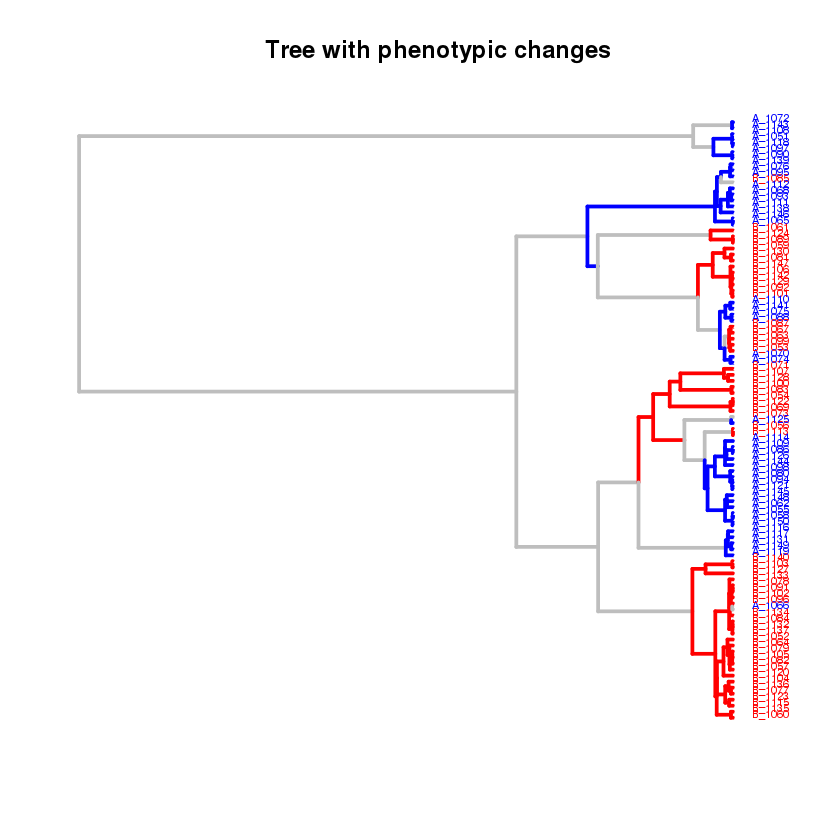

In [38]:
# We plot the tree and we map the phenotypic changes onto it
p <- plot.phen(tree, phen.nodes=phen.plot.col$all.nodes)

Note: Updating n.snps.sim to match 10x the number of real loci after data cleaning.
                Input: 200030 -->
                Updated: 184510
[1] "treeWAS snps sim done @ 2018-02-20 15:15:21"
[1] "Reconstructions completed @ 2018-02-20 15:15:57"
[1] "Started running terminal test @ 2018-02-20 15:15:57"
[1] "Real data scores completed for terminal test @ 2018-02-20 15:15:57"
[1] "Simulated data scores completed for terminal test @ 2018-02-20 15:15:57"
[1] "Started running simultaneous test @ 2018-02-20 15:15:57"
[1] "Real data scores completed for simultaneous test @ 2018-02-20 15:15:57"
[1] "Simulated data scores completed for simultaneous test @ 2018-02-20 15:15:58"
[1] "Started running subsequent test @ 2018-02-20 15:15:58"
[1] "Real data scores completed for subsequent test @ 2018-02-20 15:15:58"
[1] "Simulated data scores completed for subsequent test @ 2018-02-20 15:16:00"
[1] "Finished running terminal test @ 2018-02-20 15:16:02"
[1] "Finished running simultaneous test @ 

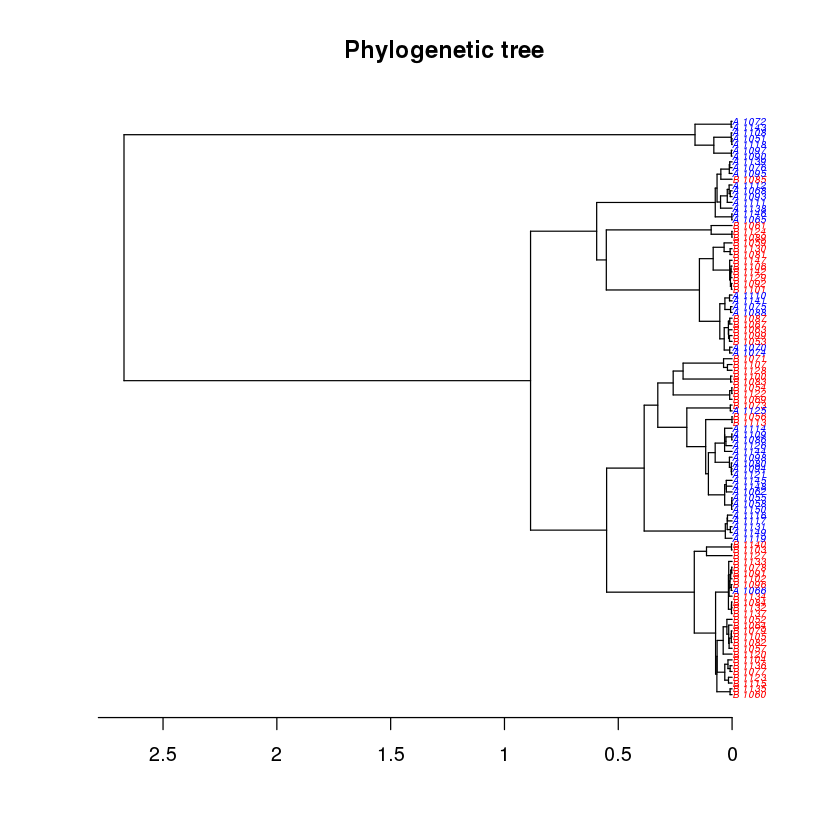

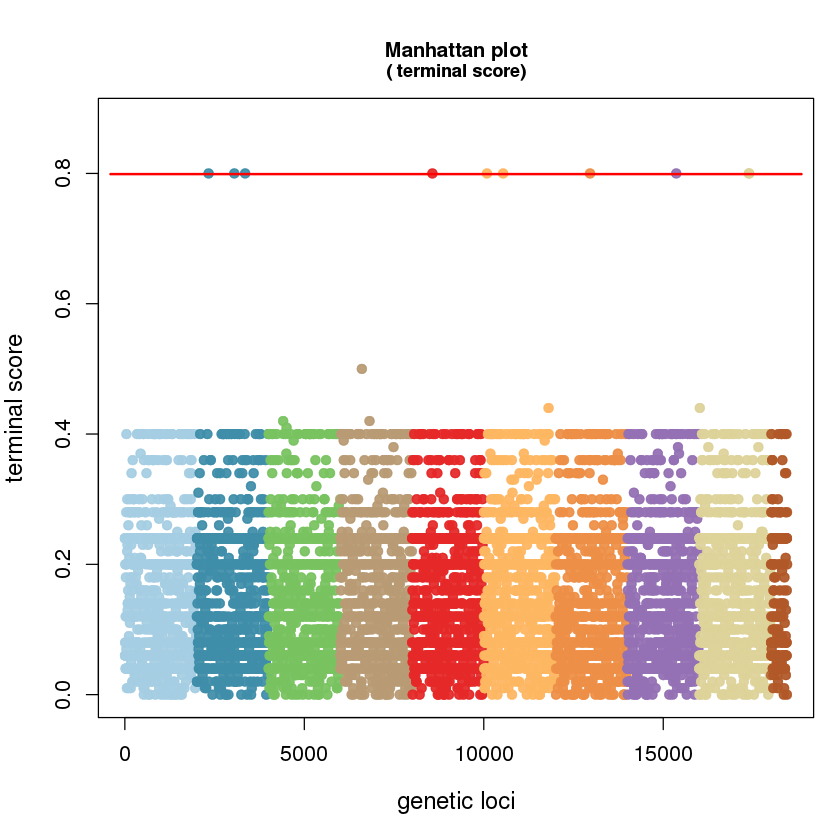

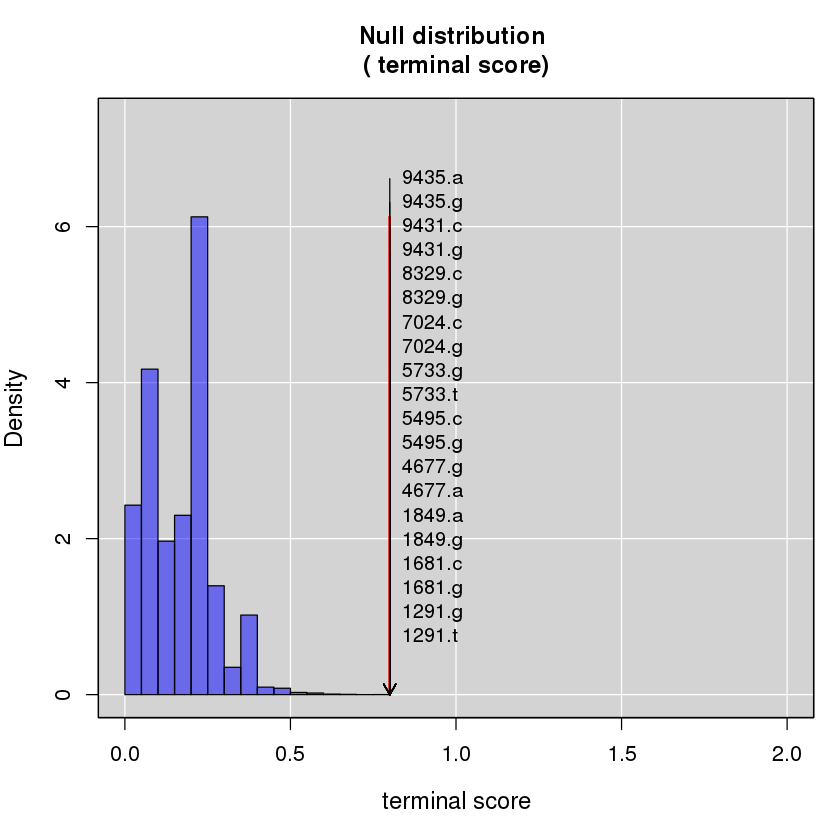

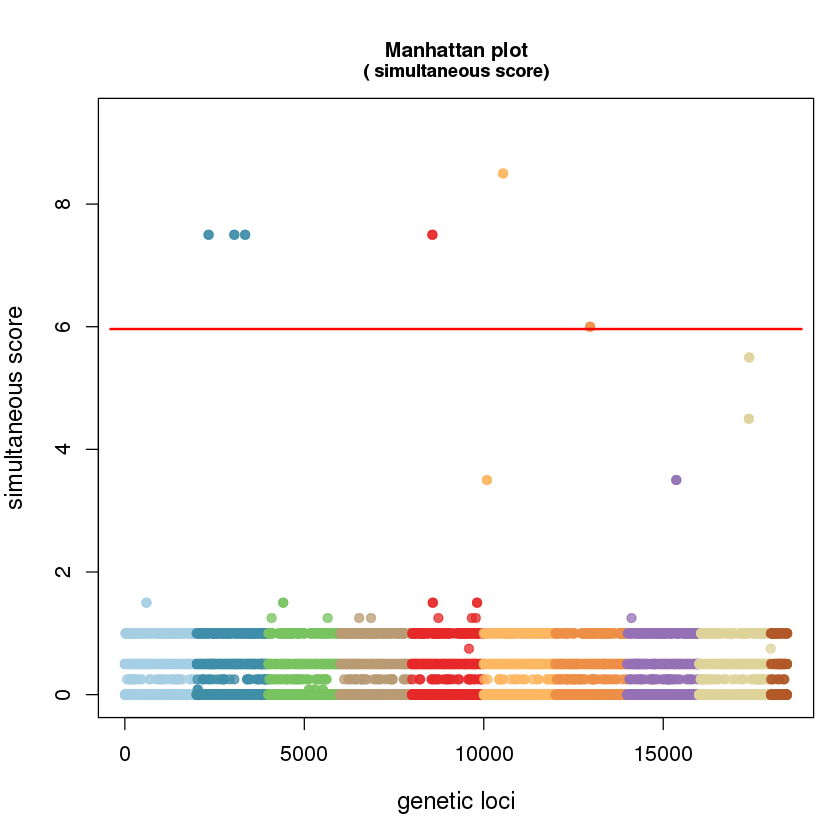

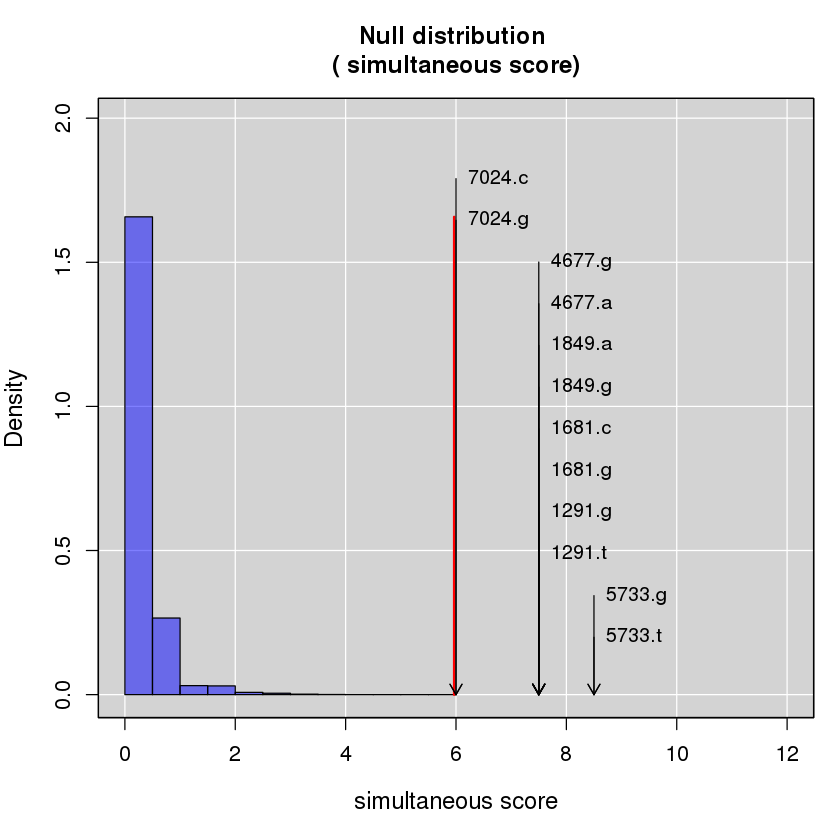

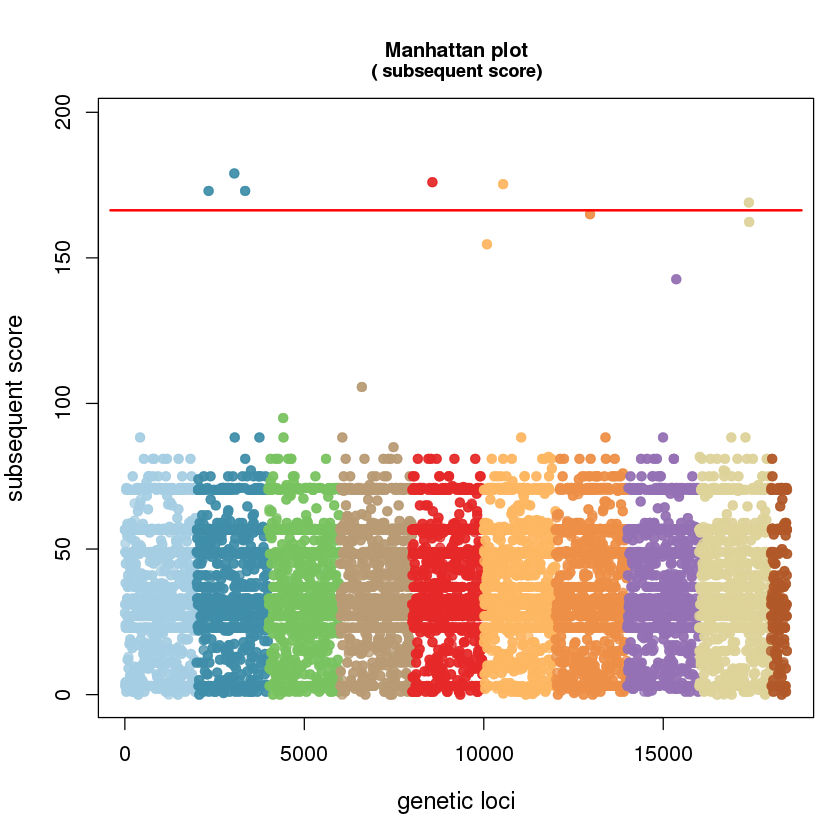

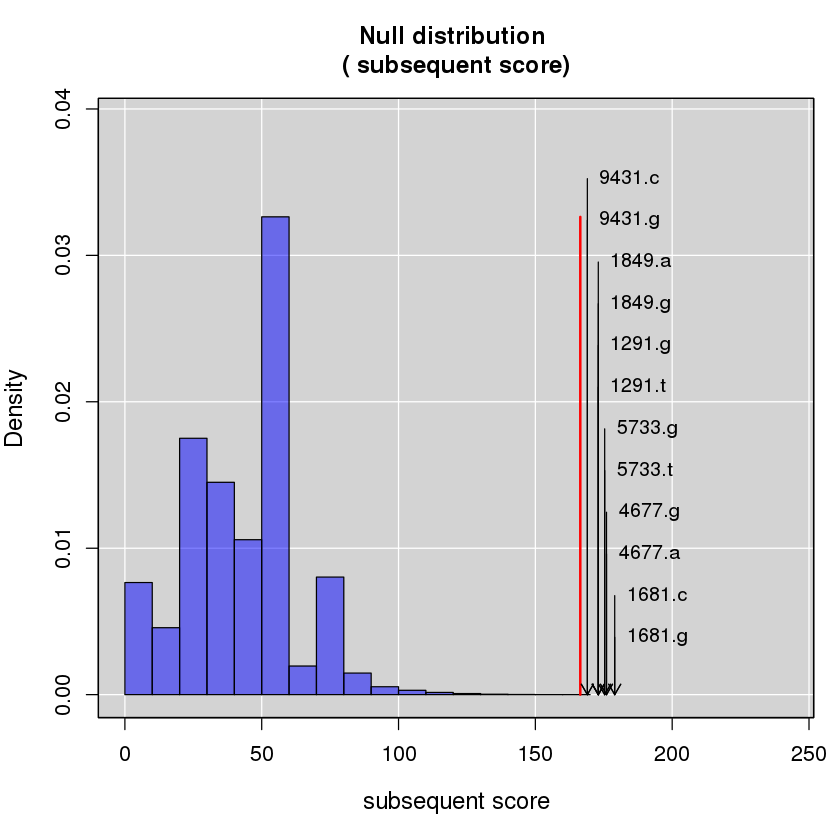

In [17]:
# We perform the main analysis
out <- treeWAS(snps = snps,
                phen = phen,
                tree = tree,
                n.subs = NULL,
                n.snps.sim = ncol(snps)*10,
                chunk.size = ncol(snps),
                test = c("terminal", "simultaneous", "subsequent"),
                snps.reconstruction =  "parsimony",
                snps.sim.reconstruction = "parsimony",
                phen.reconstruction = "parsimony",
                phen.type = NULL,
                na.rm = TRUE,
                p.value = 0.01,
                p.value.correct = "bonf",
                p.value.by = "count",
                dist.dna.model = "JC69",
                plot.tree = TRUE,
                plot.manhattan = TRUE,
                plot.null.dist = TRUE,
                plot.dist = FALSE,
                snps.assoc = NULL, 
                filename.plot = NULL,
                seed = 1)

In [18]:
print(out, sort.by.p=FALSE)

	#################### 
	## treeWAS output ## 
	#################### 
	 
	#################### 
	## All findings:  ## 
	#################### 
Number of significant loci: [1] 20
Significant loci: 
 [1] "1291.t" "1291.g" "1681.g" "1681.c" "1849.g" "1849.a" "4677.a" "4677.g"
 [9] "5495.g" "5495.c" "5733.t" "5733.g" "7024.g" "7024.c" "8329.g" "8329.c"
[17] "9431.g" "9431.c" "9435.g" "9435.a"
	 
	######################## 
	## Findings by test:  ## 
	######################## 
	 ####################  
	 ##  terminal test ## 
	 ####################  
Number of significant loci: 
[1] 20
Significance threshold: 
99.99998% 
0.7993333 
Significant loci: 
       SNP.locus p.value score G1P1 G0P0 G1P0 G0P1
1291.t      2333       0   0.8   49   41    4    6
1291.g      2334       0  -0.8    6    4   41   49
1681.g      3049       0   0.8   49   41    4    6
1681.c      3050       0  -0.8    6    4   41   49
1849.g      3351       0   0.8   49   41    4    6
1849.a      3352       0  -0.8    6    4   4

In [40]:
write.treeWAS(out, "data/treeWAS_results")

Warning message:
In if (is.na(name)) {: the condition has length > 1 and only the first element will be used